<a href="https://colab.research.google.com/github/1kaiser/Media-Segment-Depth-MLP/blob/main/JAXDepthAnythingV2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## stage 1

In [ ]:
# -*- coding: utf-8 -*-
"""
Part 1: Data Generation for Multi-Head Depth Training

This script prepares all necessary data:
1. Extracts frames from a source video.
2. Generates NORMALIZED depth maps (0-255 images) using the base teacher model.
3. Generates METRIC depth maps (floating-point meters) using the same teacher model,
   but by providing a focal length during inference.
"""

############# 1. SETUP AND INSTALLATIONS #############

print("⏳ Installing necessary libraries for data generation...")
!pip install --quiet torch torchvision transformers opencv-python-headless Pillow requests

from google.colab import output
output.clear()
print("✅ Libraries installed successfully.")

############# 2. LIBRARY IMPORTS #############

import os
import torch
import requests
import cv2
import numpy as np
from PIL import Image
from tqdm.notebook import tqdm
from transformers import AutoImageProcessor, AutoModelForDepthEstimation

############# 3. CONFIGURATION (Corrected) #############

# --- Teacher Models ---
# The model for both tasks is the same. The mode is switched by the processor call.
NORMALIZED_TEACHER = "depth-anything/Depth-Anything-V2-Large-hf"

# --- THE FIX ---
# The model fine-tuned on NYU is not hosted under a separate name.
# We use the same base model and activate metric mode by passing a focal length.
METRIC_TEACHER = "depth-anything/Depth-Anything-V2-Large-hf"
# --- END OF FIX ---

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

# --- Data Sources and Directories ---
VIDEO_URL = "https://github.com/1kaiser/Media-Segment-Depth-MLP/releases/download/v0.2/video.mp4"
INPUT_FRAMES_DIR = "input_frames"
NORMALIZED_DEPTH_DIR = "normalized_depth_maps"
METRIC_DEPTH_DIR = "metric_depth_maps"
VIDEO_FILENAME = "video.mp4"

############# 4. HELPER FUNCTIONS #############

def download_video(url, local_filename):
    """Downloads the video file if it doesn't already exist."""
    if not os.path.exists(local_filename):
        print(f"⬇️ Downloading video from {url}...")
        with requests.get(url, stream=True) as r:
            r.raise_for_status()
            with open(local_filename, 'wb') as f:
                for chunk in r.iter_content(chunk_size=8192):
                    f.write(chunk)
    else:
        print(f"✅ Video already exists: '{local_filename}'")

def extract_frames(video_path, output_dir):
    """Extracts all frames from the video into a directory."""
    if os.path.exists(output_dir) and len(os.listdir(output_dir)) > 0:
        print(f"✅ Frames already exist in '{output_dir}'. Skipping extraction.")
        return
    print(f"🎥 Extracting frames from '{video_path}' to '{output_dir}'...")
    os.makedirs(output_dir, exist_ok=True)
    cap = cv2.VideoCapture(video_path)
    frame_count = 0
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret: break
        cv2.imwrite(os.path.join(output_dir, f"frame_{frame_count:04d}.png"), frame)
        frame_count += 1
    cap.release()
    print(f"✅ Extracted {frame_count} frames.")

def generate_depth_maps(model_name, input_dir, output_dir, is_metric=False):
    """Generic function to generate depth maps using a specified teacher model."""
    task_name = "METRIC" if is_metric else "NORMALIZED"
    print(f"\n🤖 Loading {task_name} Teacher Model: {model_name} on {DEVICE}")
    processor = AutoImageProcessor.from_pretrained(model_name)
    model = AutoModelForDepthEstimation.from_pretrained(model_name).to(DEVICE)
    os.makedirs(output_dir, exist_ok=True)
    image_files = sorted([f for f in os.listdir(input_dir) if f.endswith('.png')])
    print(f"🔮 Generating {task_name} depth maps for {len(image_files)} frames...")

    for filename in tqdm(image_files, desc=f"Generating {task_name} Maps"):
        raw_image = Image.open(os.path.join(input_dir, filename)).convert('RGB')

        # Prepare model inputs based on whether metric scale is needed
        if is_metric:
            # Providing a focal_length activates the metric depth mode.
            inputs = processor(images=raw_image, return_tensors="pt", focal_length=1000.0).to(DEVICE)
        else:
            inputs = processor(images=raw_image, return_tensors="pt").to(DEVICE)

        with torch.no_grad():
            outputs = model(**inputs)
            predicted_depth = outputs.predicted_depth

        prediction = torch.nn.functional.interpolate(predicted_depth.unsqueeze(1), size=raw_image.size[::-1], mode="bicubic", align_corners=False).squeeze()
        depth_numpy = prediction.cpu().numpy()

        if is_metric:
            # Save as .npy to preserve float precision for meters
            output_filename = os.path.splitext(filename)[0] + ".npy"
            np.save(os.path.join(output_dir, output_filename), depth_numpy)
        else:
            # Normalize to 0-255 and save as .png image
            formatted = (depth_numpy * 255 / np.max(depth_numpy)).astype('uint8')
            Image.fromarray(formatted).save(os.path.join(output_dir, filename))

    print(f"✅ All {task_name} depth maps generated successfully.")

############# 5. EXECUTION BLOCK #############

if __name__ == "__main__":
    print("--- Starting Data Generation Pipeline ---")

    # Always ensure frames are extracted first
    download_video(VIDEO_URL, VIDEO_FILENAME)
    extract_frames(VIDEO_FILENAME, INPUT_FRAMES_DIR)

    # Generate NORMALIZED depth maps (if not already done)
    if not os.path.exists(NORMALIZED_DEPTH_DIR) or not os.listdir(NORMALIZED_DEPTH_DIR):
        generate_depth_maps(NORMALIZED_TEACHER, INPUT_FRAMES_DIR, NORMALIZED_DEPTH_DIR, is_metric=False)
    else:
        print(f"✅ Normalized depth maps already exist in '{NORMALIZED_DEPTH_DIR}'.")

    # Generate METRIC depth maps (if not already done)
    if not os.path.exists(METRIC_DEPTH_DIR) or not os.listdir(METRIC_DEPTH_DIR):
        generate_depth_maps(METRIC_TEACHER, INPUT_FRAMES_DIR, METRIC_DEPTH_DIR, is_metric=True)
    else:
        print(f"✅ Metric depth maps already exist in '{METRIC_DEPTH_DIR}'.")

    print("\n🎉 All datasets prepared successfully! You are now ready to run the training script.")

In [ ]:
# prompt: do an code to zipp bothe the folders input_frames and depth_maps

!zip -r data.zip input_frames normalized_depth_maps
!zip -r metric_depth_maps.zip metric_depth_maps

## stage 2

In [ ]:
!wget -nc -q https://github.com/1kaiser/Media-Segment-Depth-MLP/releases/download/v0.2/input_depthMaps.zip
!wget -nc -q https://github.com/1kaiser/Media-Segment-Depth-MLP/releases/download/v0.2/metric_depth_maps.zip
!unzip /content/input_depthMaps.zip
!unzip /content/metric_depth_maps.zip

Archive:  /content/input_depthMaps.zip
   creating: input_frames/
  inflating: input_frames/frame_0495.png  
  inflating: input_frames/frame_0111.png  
  inflating: input_frames/frame_0254.png  
  inflating: input_frames/frame_0722.png  
  inflating: input_frames/frame_0090.png  
  inflating: input_frames/frame_0765.png  
  inflating: input_frames/frame_0311.png  
  inflating: input_frames/frame_0150.png  
  inflating: input_frames/frame_0118.png  
  inflating: input_frames/frame_0179.png  
  inflating: input_frames/frame_0884.png  
  inflating: input_frames/frame_0139.png  
  inflating: input_frames/frame_0788.png  
  inflating: input_frames/frame_0861.png  
  inflating: input_frames/frame_0945.png  
  inflating: input_frames/frame_0588.png  
  inflating: input_frames/frame_0802.png  
  inflating: input_frames/frame_0905.png  
  inflating: input_frames/frame_0876.png  
  inflating: input_frames/frame_0467.png  
  inflating: input_frames/frame_1004.png  
  inflating: input_frames/frame

## training

✅ Libraries installed successfully.

--- 🚀 Training the JAX Multi-Head Student Model on TPU ---


ℹ️ No checkpoint found. Starting training from scratch.

--- Epoch 1/15 (Resuming from Epoch 1) ---


Epoch 1: 0batch [00:00, ?batch/s]

Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


✅ Checkpoint saved at step 63
Visualizing results for the last batch of the epoch...


Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


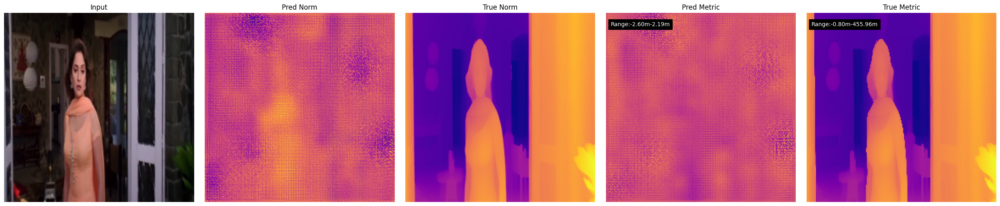


--- Epoch 2/15 (Resuming from Epoch 1) ---


Epoch 2: 0batch [00:00, ?batch/s]

Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


✅ Checkpoint saved at step 126
Visualizing results for the last batch of the epoch...


Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


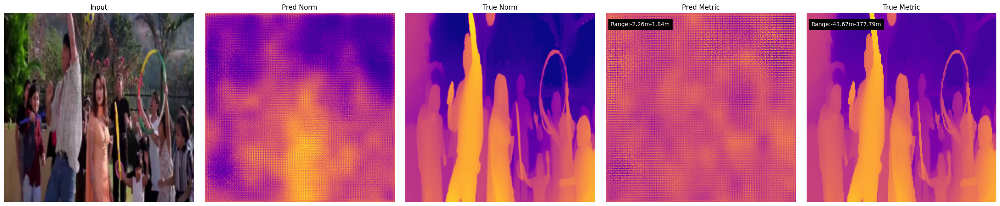


--- Epoch 3/15 (Resuming from Epoch 1) ---


Epoch 3: 0batch [00:00, ?batch/s]

Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


✅ Checkpoint saved at step 189
Visualizing results for the last batch of the epoch...


Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


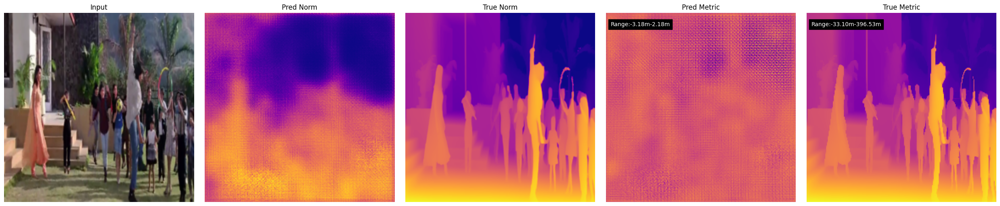


--- Epoch 4/15 (Resuming from Epoch 1) ---


Epoch 4: 0batch [00:00, ?batch/s]

Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


✅ Checkpoint saved at step 252
Visualizing results for the last batch of the epoch...


Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


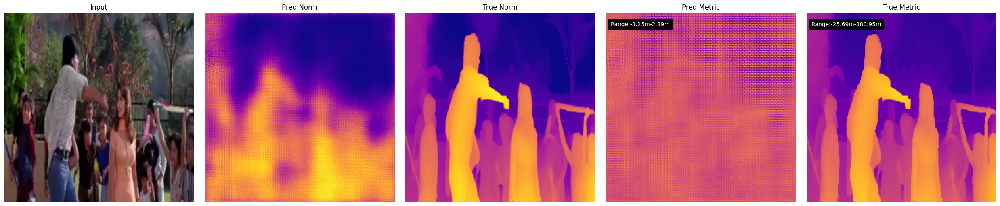


--- Epoch 5/15 (Resuming from Epoch 1) ---


Epoch 5: 0batch [00:00, ?batch/s]

Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


✅ Checkpoint saved at step 315
Visualizing results for the last batch of the epoch...


Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


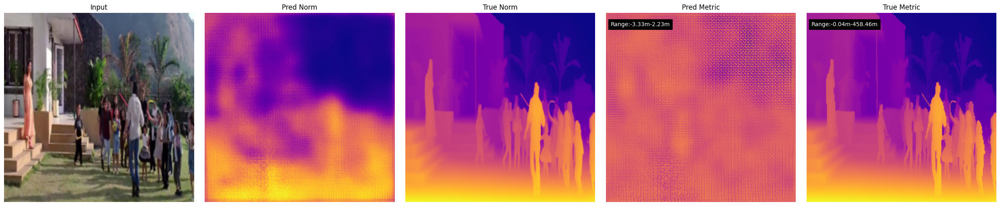


--- Epoch 6/15 (Resuming from Epoch 1) ---


Epoch 6: 0batch [00:00, ?batch/s]

Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


✅ Checkpoint saved at step 378
Visualizing results for the last batch of the epoch...


Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


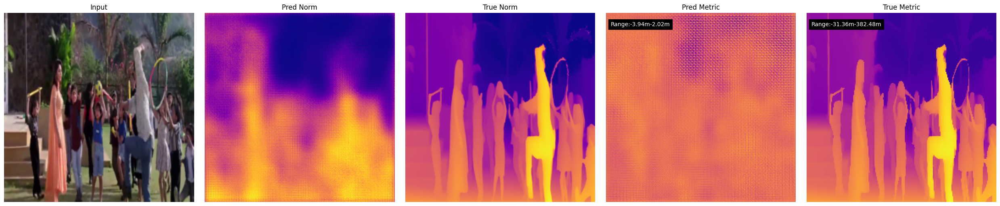


--- Epoch 7/15 (Resuming from Epoch 1) ---


Epoch 7: 0batch [00:00, ?batch/s]

Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


✅ Checkpoint saved at step 441
Visualizing results for the last batch of the epoch...


Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


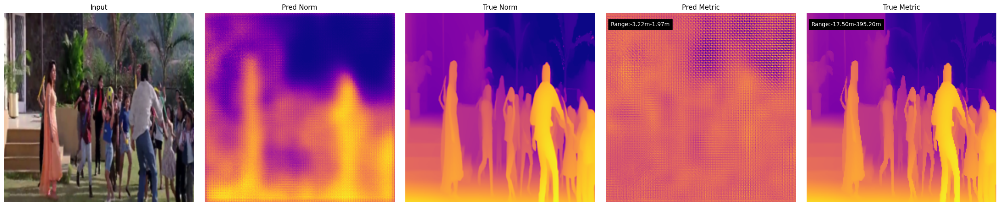


--- Epoch 8/15 (Resuming from Epoch 1) ---


Epoch 8: 0batch [00:00, ?batch/s]

Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


✅ Checkpoint saved at step 504
Visualizing results for the last batch of the epoch...


Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


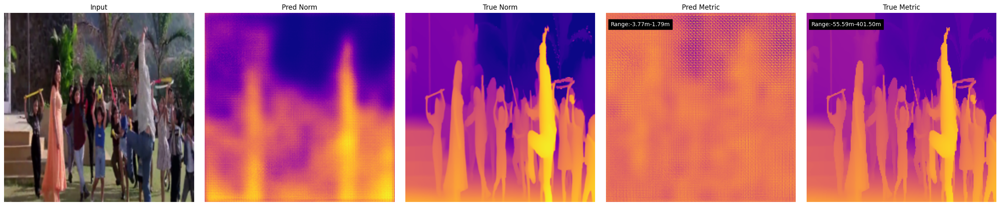


--- Epoch 9/15 (Resuming from Epoch 1) ---


Epoch 9: 0batch [00:00, ?batch/s]

Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


✅ Checkpoint saved at step 567
Visualizing results for the last batch of the epoch...


Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


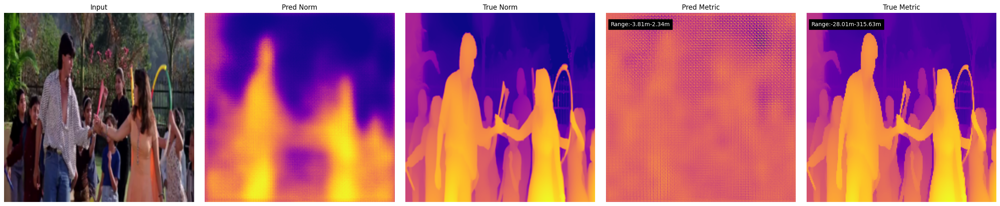


--- Epoch 10/15 (Resuming from Epoch 1) ---


Epoch 10: 0batch [00:00, ?batch/s]

Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


✅ Checkpoint saved at step 630
Visualizing results for the last batch of the epoch...


Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


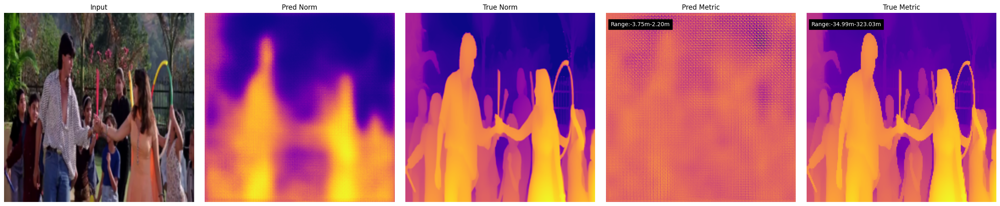


--- Epoch 11/15 (Resuming from Epoch 1) ---


Epoch 11: 0batch [00:00, ?batch/s]

Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


✅ Checkpoint saved at step 693
Visualizing results for the last batch of the epoch...


Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


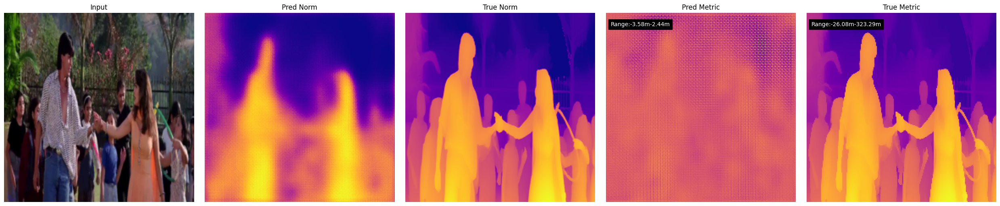


--- Epoch 12/15 (Resuming from Epoch 1) ---


Epoch 12: 0batch [00:00, ?batch/s]

Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


✅ Checkpoint saved at step 756
Visualizing results for the last batch of the epoch...


Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


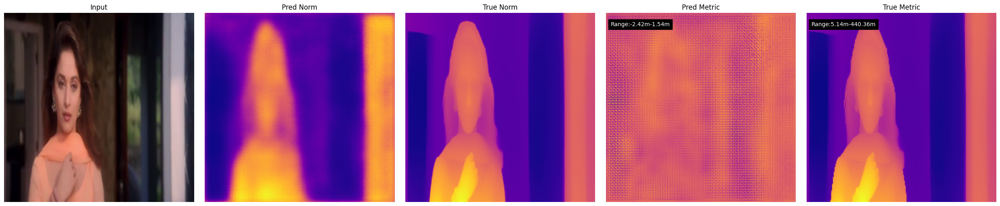


--- Epoch 13/15 (Resuming from Epoch 1) ---


Epoch 13: 0batch [00:00, ?batch/s]

Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


✅ Checkpoint saved at step 819
Visualizing results for the last batch of the epoch...


Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


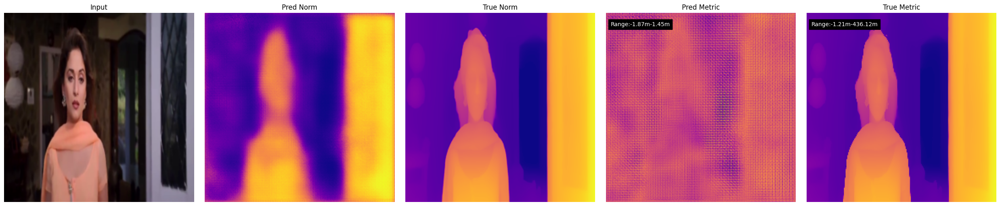


--- Epoch 14/15 (Resuming from Epoch 1) ---


Epoch 14: 0batch [00:00, ?batch/s]

Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


✅ Checkpoint saved at step 882
Visualizing results for the last batch of the epoch...


Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


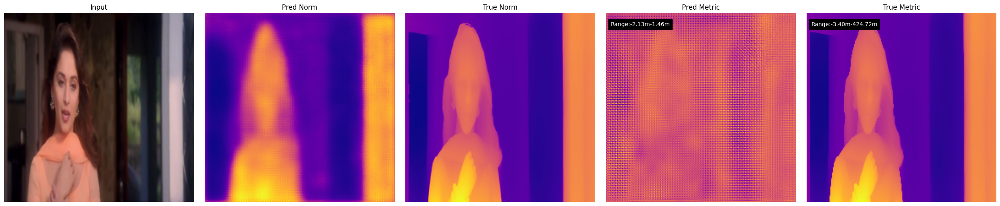


--- Epoch 15/15 (Resuming from Epoch 1) ---


Epoch 15: 0batch [00:00, ?batch/s]

Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


✅ Checkpoint saved at step 945
Visualizing results for the last batch of the epoch...


Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


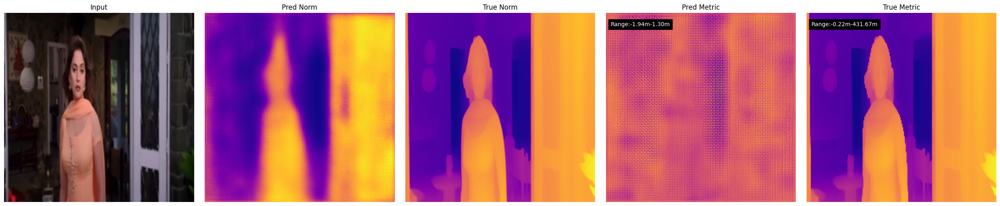


✅ Multi-head model training complete.


In [ ]:
# -*- coding: utf-8 -*-
"""
Part 2: JAX Multi-Head Student Model Training Script
(Corrected for Absolute Checkpoint Path)
"""

############# 1. SETUP AND INSTALLATIONS #############

print("⏳ Installing necessary libraries for JAX training...")
!pip install --quiet "flax>=0.6.0" "jax[tpu]>=0.3.25" -f https://storage.googleapis.com/jax-releases/libtpu_releases.html
!pip install --quiet transformers opencv-python-headless optax ml-collections einops Pillow

from google.colab import output
output.clear()
print("✅ Libraries installed successfully.")

############# 2. LIBRARY IMPORTS #############

import os
import jax
import jax.numpy as jnp
import flax.linen as nn
import optax
import numpy as np
import matplotlib.pyplot as plt
import ml_collections
import random
import cv2
from PIL import Image
from tqdm.notebook import tqdm
from functools import partial
from einops import rearrange
from flax.training import train_state
from flax.jax_utils import replicate, unreplicate
import orbax.checkpoint as ocp
from transformers import AutoImageProcessor, FlaxViTModel

############# 3. CONFIGURATION #############

STUDENT_MODEL_NAME = "google/vit-base-patch16-224-in21k"
INPUT_FRAMES_DIR = "input_frames"
NORMALIZED_DEPTH_DIR = "depth_maps"
METRIC_DEPTH_DIR = "metric_depth_maps"

# --- THE FIX ---
# Provide an absolute path for the checkpoint directory. In Colab, this is /content/.
CHECKPOINT_DIR = "/content/checkpoints_multihead_student"
# --- END OF FIX ---

LEARNING_RATE = 1e-5
TOTAL_EPOCHS = 15
BATCH_SIZE = 8 * 2

############# 4. JAX MULTI-HEAD MODEL ARCHITECTURE #############

class DPTFeatureFusionBlock(nn.Module):
    features: int
    @nn.compact
    def __call__(self, x, skip):
        skip_aligned = jax.image.resize(nn.Conv(self.features,(1,1))(skip), x.shape, 'bilinear')
        fused = x + skip_aligned
        return nn.Conv(self.features,(3,3),padding="SAME")(nn.gelu(nn.Conv(self.features,(3,3),padding="SAME")(fused)))

class DensePredictionHead(nn.Module):
    decoder_channels: tuple = (256, 128, 64, 32)
    @nn.compact
    def __call__(self, features):
        deepest, skips = features[0], features[1:]
        x = nn.Conv(self.decoder_channels[0],(1,1))(deepest)
        for i, c in enumerate(self.decoder_channels):
            x = nn.ConvTranspose(c,(2,2),strides=(2,2),padding="SAME")(x)
            if i < len(skips): x = DPTFeatureFusionBlock(c)(x, skips[i])
        return x

class MultiHeadViTDepthModel(nn.Module):
    feature_layers: tuple = (11, 7, 5, 3)
    def setup(self):
        self.vit = FlaxViTModel.from_pretrained(STUDENT_MODEL_NAME, output_hidden_states=True)
        self.decoder = DensePredictionHead()
        self.normalized_head = nn.Conv(1, (3, 3), padding="SAME", name="normalized_prediction_head")
        self.metric_head = nn.Conv(1, (3, 3), padding="SAME", name="metric_prediction_head")

    def __call__(self, pixels, train=False):
        outputs = self.vit(pixels, train=train, output_hidden_states=True)
        reshape = lambda f: rearrange(f[:,1:,:], 'b (h w) c -> b h w c', h=14)
        features = [reshape(h) for h in [outputs.hidden_states[i] for i in self.feature_layers]]
        shared_features = self.decoder(features)
        norm_logits = self.normalized_head(shared_features)
        metric_logits = self.metric_head(shared_features)
        return {
            'normalized': nn.sigmoid(jax.image.resize(norm_logits,(pixels.shape[0],224,224,1),'bilinear')),
            'metric': jax.image.resize(metric_logits,(pixels.shape[0],224,224,1),'bilinear')
        }

############# 5. JAX MULTI-TASK TRAINING PIPELINE #############

def create_multi_task_dataloader(input_dir, norm_dir, metric_dir, batch_size):
    filenames = sorted(os.listdir(input_dir))
    random.shuffle(filenames)
    processor = AutoImageProcessor.from_pretrained(STUDENT_MODEL_NAME, size={"height":224,"width":224})
    for i in range(0, len(filenames), batch_size):
        batch_files = filenames[i:i+batch_size]
        if len(batch_files) < batch_size: continue
        inputs = [Image.open(os.path.join(input_dir,f)) for f in batch_files]
        norm_depths = [Image.open(os.path.join(norm_dir,f)).convert('L').resize((224,224)) for f in batch_files]
        metric_depths = [np.load(os.path.join(metric_dir,os.path.splitext(f)[0]+".npy")) for f in batch_files]
        pixel_values = processor(images=inputs,return_tensors='jax').pixel_values
        norm_array = np.expand_dims(np.array([np.array(d) for d in norm_depths]).astype(np.float32)/255.0,-1)
        metric_array = np.expand_dims(np.array([cv2.resize(d,(224,224),interpolation=cv2.INTER_CUBIC) for d in metric_depths]),-1)
        yield {'pixel_values':pixel_values,'targets':{'normalized':jnp.array(norm_array),'metric':jnp.array(metric_array)}}

def compute_single_task_loss(pred, true, l1_w=0.85, sobel_w=0.15):
    l1=jnp.mean(jnp.abs(pred-true)); s_x=jnp.array([[-1,0,1],[-2,0,2],[-1,0,1]],jnp.float32).reshape(3,3,1,1); s_y=jnp.array([[-1,-2,-1],[0,0,0],[1,2,1]],jnp.float32).reshape(3,3,1,1)
    dn = ('NHWC','HWIO','NHWC')
    pgx=jax.lax.conv_general_dilated(pred,s_x,(1,1),'SAME',dimension_numbers=dn); pgy=jax.lax.conv_general_dilated(pred,s_y,(1,1),'SAME',dimension_numbers=dn)
    tgx=jax.lax.conv_general_dilated(true,s_x,(1,1),'SAME',dimension_numbers=dn); tgy=jax.lax.conv_general_dilated(true,s_y,(1,1),'SAME',dimension_numbers=dn)
    sobel = jnp.mean(jnp.abs(pgx-tgx)+jnp.abs(pgy-tgy))
    total = l1_w*l1+sobel_w*sobel
    return total, {'loss':total,'l1':l1,'sobel':sobel}

def compute_multi_task_loss(preds, targets, norm_weight=1.0, metric_weight=0.0):
    norm_loss,norm_metrics = compute_single_task_loss(preds['normalized'], targets['normalized'])
    metric_loss,metric_metrics = compute_single_task_loss(preds['metric'], targets['metric'])
    total_loss = (norm_weight*norm_loss)+(metric_weight*metric_loss)
    metrics_out = {f"norm_{k}":v for k,v in norm_metrics.items()}
    metrics_out.update({f"metric_{k}":v for k,v in metric_metrics.items()})
    metrics_out['total_loss']=total_loss
    return total_loss, metrics_out

@partial(jax.pmap, axis_name='batch')
def train_step(state, batch, dropout_rng):
    def loss_fn(params):
        preds = state.apply_fn({'params':params, 'rngs': {'dropout': dropout_rng}}, batch['pixel_values'], train=True)
        return compute_multi_task_loss(preds, batch['targets'])
    grad_fn = jax.value_and_grad(loss_fn, has_aux=True)
    (_, metrics), grads = grad_fn(state.params)
    return state.apply_gradients(grads=jax.lax.pmean(grads, axis_name='batch')), jax.lax.pmean(metrics, axis_name='batch')

def visualize_multi_head_results(state, batch):
    sample_image = batch['pixel_values'][0:1]
    @partial(jax.jit, static_argnames=['train'])
    def predict_fn(params, image, train):
        return state.apply_fn({'params': params}, image, train=train)
    preds = predict_fn(state.params, sample_image, train=False)
    proc = AutoImageProcessor.from_pretrained(STUDENT_MODEL_NAME); mean,std=proc.image_mean,proc.image_std
    input_display = np.clip(((sample_image.squeeze().transpose(1,2,0)*np.array(std))+np.array(mean)),0,1)
    fig, axes = plt.subplots(1, 5, figsize=(25, 5))
    titles = ["Input","Pred Norm","True Norm","Pred Metric","True Metric"]
    pred_met, true_met = preds['metric'].squeeze(), batch['targets']['metric'][0].squeeze()
    normalize_viz = lambda d: (d-d.min())/(d.max()-d.min()) if d.max()>d.min() else d
    images = [input_display, preds['normalized'].squeeze(), batch['targets']['normalized'][0].squeeze(), normalize_viz(pred_met), normalize_viz(true_met)]
    for i,(ax,img,title) in enumerate(zip(axes,images,titles)):
        ax.imshow(np.asarray(img), cmap='plasma' if i > 0 else None); ax.set_title(title); ax.axis('off')
    axes[3].text(5,15,f"Range:{pred_met.min():.2f}m-{pred_met.max():.2f}m",c='w',backgroundcolor='k')
    axes[4].text(5,15,f"Range:{true_met.squeeze().min():.2f}m-{true_met.squeeze().max():.2f}m",c='w',backgroundcolor='k')
    plt.tight_layout();plt.show()

############# 6. MAIN TRAINING LOOP #############

def main_train():
    print("\n--- 🚀 Training the JAX Multi-Head Student Model on TPU ---")
    os.makedirs(CHECKPOINT_DIR, exist_ok=True)
    model = MultiHeadViTDepthModel()
    key = jax.random.PRNGKey(42)
    params = model.init({'params':key,'dropout':key},jnp.ones((1,3,224,224)),train=False)['params']
    state = train_state.TrainState.create(apply_fn=model.apply, params=params, tx=optax.adamw(LEARNING_RATE))

    checkpointer = ocp.PyTreeCheckpointer()
    options = ocp.CheckpointManagerOptions(max_to_keep=3, create=True)
    manager = ocp.CheckpointManager(CHECKPOINT_DIR, checkpointer, options)

    latest_step = manager.latest_step()
    if latest_step is not None:
        print(f"✅ Found checkpoint at step {latest_step}. Restoring...")
        state = manager.restore(latest_step, items=state)
    else:
        print("ℹ️ No checkpoint found. Starting training from scratch.")

    replicated_state = replicate(state)
    rng = jax.random.PRNGKey(0)

    def shard(batch):
        return jax.tree_util.tree_map(lambda x: x.reshape((jax.device_count(),-1)+x.shape[1:]), batch)

    num_files = len(os.listdir(INPUT_FRAMES_DIR))
    batches_per_epoch = num_files // BATCH_SIZE
    start_epoch = unreplicate(replicated_state.step) // batches_per_epoch if batches_per_epoch > 0 else 0

    for epoch in range(start_epoch, TOTAL_EPOCHS):
        print(f"\n--- Epoch {epoch+1}/{TOTAL_EPOCHS} (Resuming from Epoch {start_epoch+1}) ---")
        dataloader = create_multi_task_dataloader(INPUT_FRAMES_DIR, NORMALIZED_DEPTH_DIR, METRIC_DEPTH_DIR, BATCH_SIZE)

        last_batch = None
        with tqdm(dataloader, desc=f"Epoch {epoch+1}", unit="batch") as t:
            for batch in t:
                sharded_batch = shard(batch)
                rng, dropout_key = jax.random.split(rng)
                replicated_state, metrics = train_step(replicated_state, sharded_batch, jax.random.split(dropout_key, jax.device_count()))
                t.set_postfix(total_loss=f"{unreplicate(metrics)['total_loss']:.4f}")
                last_batch = batch

        host_state = unreplicate(replicated_state)
        manager.save(host_state.step.item(), items=host_state)
        print(f"✅ Checkpoint saved at step {host_state.step.item()}")

        if last_batch:
            print("Visualizing results for the last batch of the epoch...")
            visualize_multi_head_results(host_state, last_batch)

    print("\n✅ Multi-head model training complete.")

############# 7. EXECUTION CONTROL #############

if __name__ == "__main__":
    if not all(os.path.exists(d) for d in [INPUT_FRAMES_DIR, NORMALIZED_DEPTH_DIR, METRIC_DEPTH_DIR]):
        print("❌ Error: One or more data directories not found. Please run the data generation script first.")
    else:
        main_train()

## inferencing code

In [ ]:
# -*- coding: utf-8 -*-
"""
Part 3: JAX Multi-Head Student Model Inference Script
(Corrected for Absolute Checkpoint Path)
"""

############# 1. SETUP AND INSTALLATIONS #############

print("⏳ Installing necessary libraries for JAX inference...")
!pip install --quiet "flax>=0.6.0" "jax[tpu]>=0.3.25" -f https://storage.googleapis.com/jax-releases/libtpu_releases.html
!pip install --quiet transformers opencv-python-headless optax ml-collections einops Pillow

from google.colab import output
output.clear()
print("✅ Libraries installed successfully.")

############# 2. LIBRARY IMPORTS #############

import os
import jax
import jax.numpy as jnp
import flax.linen as nn
import optax
import numpy as np
import matplotlib.pyplot as plt
import ml_collections
import random
import cv2
from PIL import Image
from einops import rearrange
from flax.training import train_state
import orbax.checkpoint as ocp
from transformers import AutoImageProcessor, FlaxViTModel
from functools import partial

############# 3. CONFIGURATION #############

STUDENT_MODEL_NAME = "google/vit-base-patch16-224-in21k"
INPUT_FRAMES_DIR = "input_frames"

# --- THE FIX ---
# Provide an absolute path for the checkpoint directory. In Colab, this is /content/.
CHECKPOINT_DIR = "/content/checkpoints_multihead_student"
# --- END OF FIX ---

############# 4. JAX MODEL ARCHITECTURE (MUST MATCH TRAINING SCRIPT) #############

class DPTFeatureFusionBlock(nn.Module):
    features: int
    @nn.compact
    def __call__(self, x, skip):
        skip_aligned = jax.image.resize(nn.Conv(self.features,(1,1))(skip), x.shape, 'bilinear')
        fused = x + skip_aligned
        return nn.Conv(self.features,(3,3),padding="SAME")(nn.gelu(nn.Conv(self.features,(3,3),padding="SAME")(fused)))

class DensePredictionHead(nn.Module):
    decoder_channels: tuple = (256, 128, 64, 32)
    @nn.compact
    def __call__(self, features):
        deepest, skips = features[0], features[1:]
        x = nn.Conv(self.decoder_channels[0],(1,1))(deepest)
        for i, c in enumerate(self.decoder_channels):
            x = nn.ConvTranspose(c,(2,2),strides=(2,2),padding="SAME")(x)
            if i < len(skips): x = DPTFeatureFusionBlock(c)(x, skips[i])
        return x

class MultiHeadViTDepthModel(nn.Module):
    feature_layers: tuple = (11, 7, 5, 3)
    def setup(self):
        self.vit = FlaxViTModel.from_pretrained(STUDENT_MODEL_NAME, output_hidden_states=True)
        self.decoder = DensePredictionHead()
        self.normalized_head = nn.Conv(1, (3, 3), padding="SAME", name="normalized_prediction_head")
        self.metric_head = nn.Conv(1, (3, 3), padding="SAME", name="metric_prediction_head")

    def __call__(self, pixels, train=False):
        outputs = self.vit(pixels, train=train, output_hidden_states=True)
        reshape = lambda f: rearrange(f[:,1:,:], 'b (h w) c -> b h w c', h=14)
        features = [reshape(h) for h in [outputs.hidden_states[i] for i in self.feature_layers]]
        shared_features = self.decoder(features)
        norm_logits = self.normalized_head(shared_features)
        metric_logits = self.metric_head(shared_features)
        return {
            'normalized': nn.sigmoid(jax.image.resize(norm_logits,(pixels.shape[0],224,224,1),'bilinear')),
            'metric': jax.image.resize(metric_logits,(pixels.shape[0],224,224,1),'bilinear')
        }

############# 5. INFERENCE SCRIPT #############

def visualize_inference_results(input_image, predictions):
    """Displays the input image and the two predicted depth maps."""
    pred_norm = predictions['normalized'].squeeze()
    pred_metric = predictions['metric'].squeeze()
    viz_pred_metric = (pred_metric-pred_metric.min())/(pred_metric.max()-pred_metric.min()) if pred_metric.max()>pred_metric.min() else pred_metric
    fig, axes = plt.subplots(1, 3)
    titles = ["Input Frame", "Predicted Normalized Depth", "Predicted Metric Depth"]
    images = [input_image, pred_norm, viz_pred_metric]
    cmaps = [None, 'plasma', 'plasma']
    for i, (ax, img, title) in enumerate(zip(axes, images, titles)):
        ax.imshow(np.asarray(img), cmap=cmaps[i]); ax.set_title(title, fontsize=14); ax.axis('off')
    axes[2].text(10, 25, f"Min: {pred_metric.min():.2f}m\nMax: {pred_metric.max():.2f}m", c='w', backgroundcolor='k', fontsize=12, bbox=dict(facecolor='black', alpha=0.5))
    plt.tight_layout(); plt.show()

def run_inference():
    """Loads the trained student model and runs it on a random frame."""
    print("--- 🚀 Starting Inference with Trained JAX Student Model ---")
    model = MultiHeadViTDepthModel()
    dummy_input = jnp.ones((1, 3, 224, 224))
    key = jax.random.PRNGKey(42)
    state = train_state.TrainState.create(apply_fn=model.apply, params=model.init(key, dummy_input)['params'], tx=optax.adamw(1e-4))
    manager = ocp.CheckpointManager(CHECKPOINT_DIR, ocp.PyTreeCheckpointer())
    latest_step = manager.latest_step()
    if latest_step is None:
        raise FileNotFoundError(f"❌ No checkpoint found in '{CHECKPOINT_DIR}'. Please run the training script first.")
    print(f"✅ Found and loading checkpoint from step {latest_step}...")
    restored_state = manager.restore(latest_step, items=state)
    print("✅ Model weights loaded successfully.")

    print("💾 Loading a random frame for evaluation...")
    image_files = sorted([f for f in os.listdir(INPUT_FRAMES_DIR) if f.endswith('.png')])
    if not image_files: raise FileNotFoundError(f"❌ No images found in '{INPUT_FRAMES_DIR}'.")
    random_frame_path = os.path.join(INPUT_FRAMES_DIR, random.choice(image_files))
    input_image_pil = Image.open(random_frame_path).convert('RGB')
    processor = AutoImageProcessor.from_pretrained(STUDENT_MODEL_NAME, size={"height": 224, "width": 224})
    pixel_values = processor(images=input_image_pil, return_tensors='jax').pixel_values

    @partial(jax.jit, static_argnames=['train'])
    def predict_step(params, image_batch, train):
        return restored_state.apply_fn({'params': params}, image_batch, train=train)

    print("🧠 Running prediction...")
    predictions = predict_step(restored_state.params, pixel_values, train=False)

    print("🖼️  Visualizing results...")
    visualize_inference_results(input_image_pil.resize((224, 224)), predictions)

############# 6. EXECUTION BLOCK #############

if __name__ == "__main__":
    if not os.path.exists(CHECKPOINT_DIR) or not os.listdir(CHECKPOINT_DIR):
        print(f"❌ Error: Checkpoint directory '{CHECKPOINT_DIR}' not found or is empty.")
    else:
        run_inference()

⏳ Installing necessary libraries for JAX inference...
